# Processing modules
This Notebook processes detected communities by *Infomap* (called *modules* internally) that are stored in a `.clu` format.

In [1]:
%cd /Users/Karsten/Dev/marine-spatial-structure
%pwd

/Users/Karsten/Dev/marine-spatial-structure


'/Users/Karsten/Dev/marine-spatial-structure'

In [2]:
import pickle
import sys
from pathlib import Path

sys.path.insert(1, str(Path.cwd() / 'utils'))
from classifications import *  # noqa: E402
from plot import plot_modules, plot_quality, plot_boundary_persistence, plot_hexbins  # noqa: E402

## Reading modules
*Infomap* outputs a `.clu` file listing every node and the module to which they belong. The seed that yields the "best" partition is indicated by how well it minimizes the map equation (the seed that produces the minimum codelength) and is used hereafter.

In [3]:
particle_type = Unrestricted
season = Season.fall
markov_time = 2

with open(Path.cwd() / 'network' / 'label_map.pickle', 'rb') as file:
    label_map = pickle.load(file)

with open(Path.cwd() / 'network' / particle_type.name / season.name / 'edges.pickle', 'rb') as file:
    edges = pickle.load(file)

with open(Path.cwd() / 'network' / particle_type.name / season.name / 'transition_matrix.pickle', 'rb') as file:
    transition_matrix = pickle.load(file)

In [4]:
path = Path.cwd() / 'network' / particle_type.name / season.name / str(markov_time)
seeds = list(sorted((path / 'clus').rglob('seed_*.txt')))
seed = 90

modules, hexbins = Module.read_clu(seeds[seed], label_map, display_clu=True)

,node,module,flow
0,155,1,0.014881
1,195,1,0.012938
2,170,1,0.012896
3,157,1,0.012675
4,182,1,0.012270
...,...,...,...
5223,2446,17,0.000059
5224,3611,18,0.000037
5225,3789,18,0.000000
5226,2447,19,0.000001


In [5]:
# Create a hash map to assign an h3 index to an existing Hexbin object
hexbin_dict = dict((hexbin.h3, hexbin) for hexbin in hexbins)

# Represent particle trajectories as a tuple of reference Hexbins
trajectories = [(hexbin_dict[source_node], hexbin_dict[target_node]) for source_node, target_node in edges]

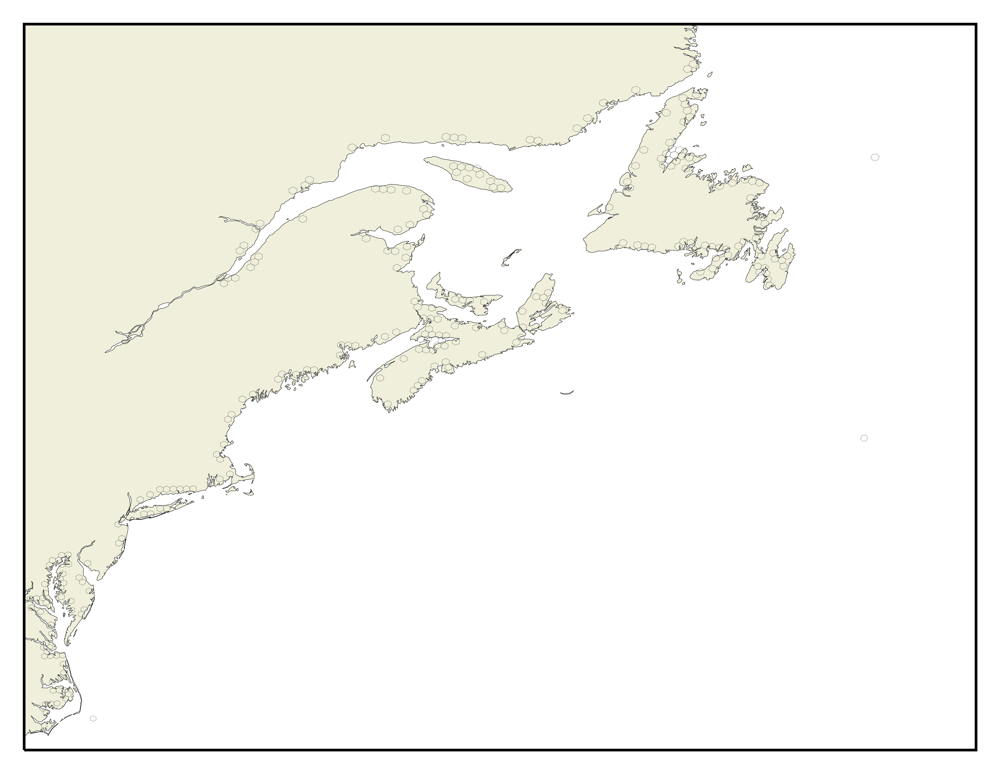

In [6]:
# Get all hexbins in the domain that aren't used
domain_hexbins = [Hexbin(domain_node) for domain_node in label_map.keys() 
                  if all([domain_node != hexbin for hexbin in hexbins])]
plot_hexbins(domain_hexbins)

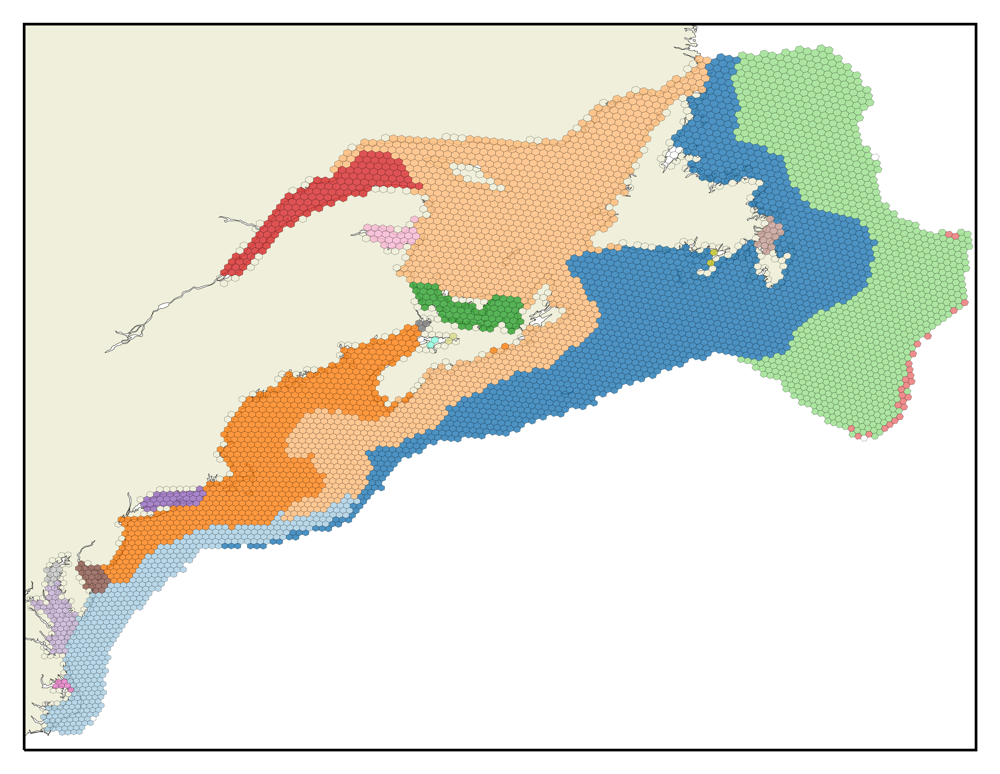

In [7]:
module_colors = ['#a6cee3', '#1f77b4', '#ffbb78', '#ff7f0e', '#98df8a', '#2ca02c', '#eb7171', '#d62728', '#c5b0d5', '#9467bd',
                 '#c49c94', '#8c564b', '#f7b6d2', '#e377c2', '#c7c7c7', '#7f7f7f', '#dbdb8d', '#bcbd22', '#85ffdc', '#60d6b5',
                 '#c26787', '#960337',]

path = Path.cwd() / 'network' / particle_type.name / season.name / str(markov_time) / 'figs'
plot_modules(hexbins, module_colors, other_hexagons=domain_hexbins)

## Quality parameters

The quality of the network partition can be evaluated by three parameters that assess particle modular movement:

1. *Coherence ratio* (Ser-Giacomi et al. 2015), 
2. *Fortress ratio*,
3. *Mixing parameter* (Ser-Giacomi et al. 2015).

The quality of each module is evaluated individually to assess the strength of its barriers.


### Coherence ratio

The coherence ratio $\rho_{t_0}^{\tau_\alpha}(m)$ of a community $m$ is the probability for a particle to end in $m$ given that it started in $m$, $\mathbb{P}\left(\mathbf{x}_\alpha(t_0 + \tau_\alpha) \in m | \mathbf{x}_\alpha(t_0) \in m\right)$. It assesses the outward strength of the boundaries defining $m$. The coherence ratio ranges $0 \leq \rho_{t_0}^{\tau_\alpha}(m) \leq 1$, where $\rho_{t_0}^{\tau_\alpha}(m) = 1$ means that every particle starting in $m$ ended in $m$, i.e., the community is perfectly coherent. It is given by
$$
    \rho_{t_0}^{\tau_\alpha}(m) = \frac{
    \sum_{i,j \in m}\#\left\{B_i(t_0)\right\}\mathbf{P}(t_0, \tau_\alpha)_{ij}
    }{
    \sum_{i \in m}\#\left\{B_i(t_0)\right\}
    },
$$
as defined by Ser-Giacomi et al. 2015.


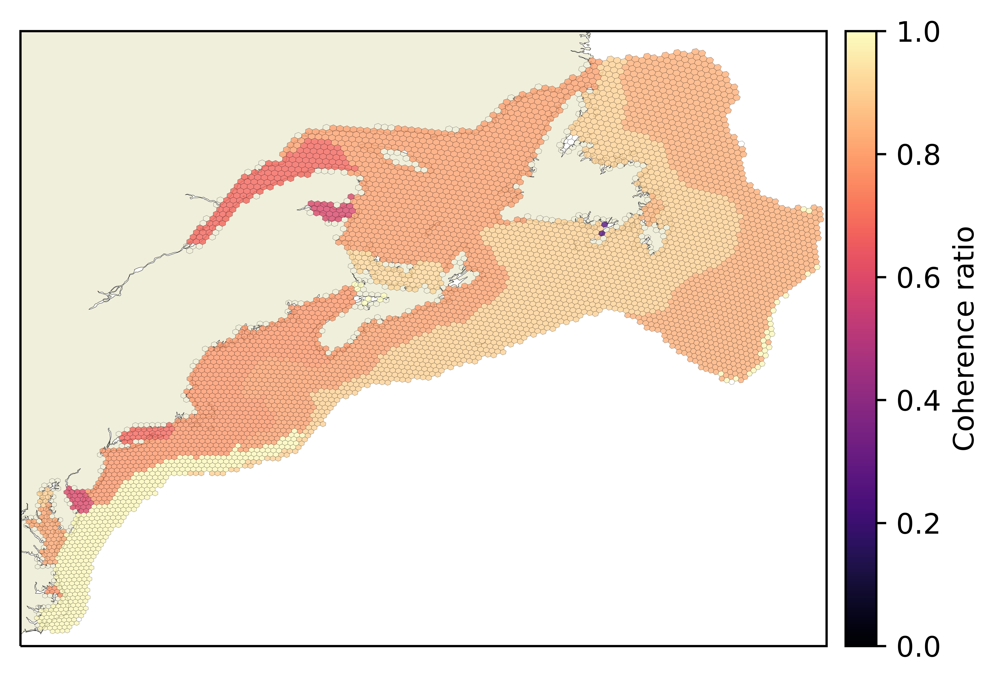

In [8]:
for module in modules:
    module.calculate_coherence(trajectories)

plot_quality(
    hexbins,
    parameter='coherence',
    other_hexagons=domain_hexbins,
    colorbar_label='Coherence ratio',
)

### Fortress ratio

The fortress ratio $\kappa_{t_0}^{\tau_\alpha}(m)$ of a community $m$ is the probability for a particle to have started in $m$ given that it ended $m$, $\mathbb{P}\left(\mathbf{x}_\alpha(t_0) \in m | \mathbf{x}_\alpha(t_0 + \tau_\alpha) \in m\right)$. It assesses the inward strength of the boundaries defining $m$. The fortress ratio ranges $0 \leq \kappa_{t_0}^{\tau_\alpha}(m) \leq 1$, where $\kappa_{t_0}^{\tau_\alpha}(m) = 1$ means that every particle ending in $m$ started in $m$, i.e., the community acts as a perfect fortress. It is given by
$$
    \kappa_{t_0}^{\tau_\alpha}(m) = \frac{
    \sum_{i,j \in m}\#\left\{B_i(t_0)\right\}\mathbf{P}(t_0, \tau_\alpha)_{ij}
    }{
    \sum_{i \in m}\#\left\{B_i(t_0 + \tau_\alpha)\right\}
    }.
$$


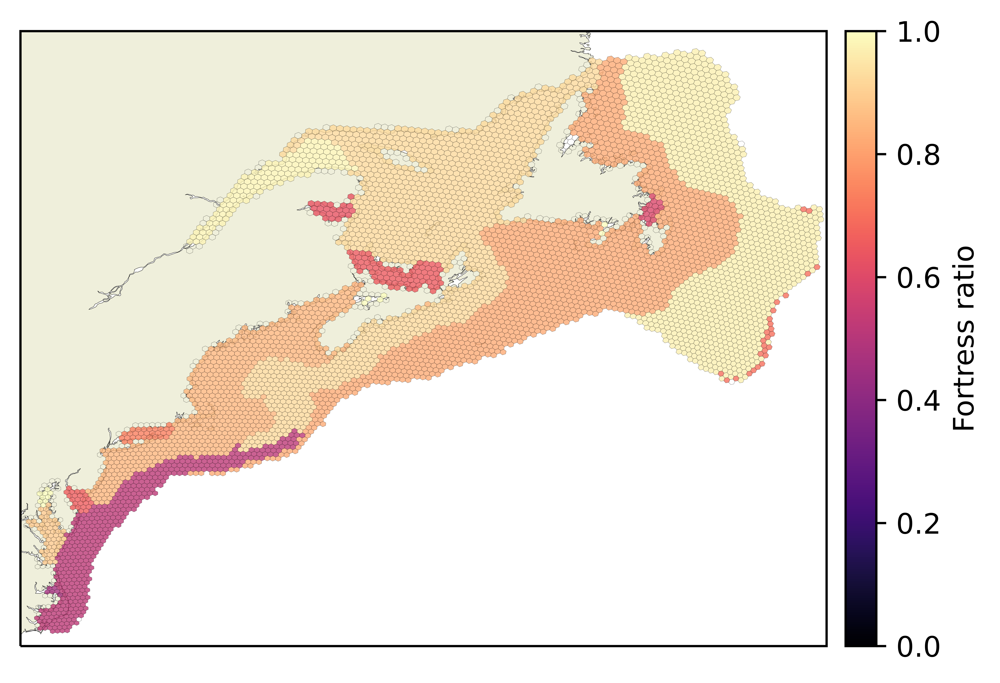

In [9]:
for module in modules:
    module.calculate_fortress(trajectories)

plot_quality(
    hexbins,
    parameter='fortress',
    other_hexagons=domain_hexbins,
    colorbar_label='Fortress ratio',
)

### Mixing parameter

To calculate the mixing parameter $M_{t_0}^{\tau_\alpha}(m)$ of a community $m$, we follow Ser-Giacomi et al. and first define a *transport matrix* from our transition matrix that represents only the transitions occurring between vertices $i, j \in m$:
$$
    \mathbf{R}(t_0, \tau_\alpha | m)_{ij} = \frac{
    \mathbf{P}(t_0, \tau_\alpha)_{ij}
    }{
    \sum_{k \in m}\mathbf{P}(t_0, \tau_\alpha)_{ik}
    }.
$$
Then, the mixing parameter is given by
$$
    M_{t_0}^{\tau_\alpha}(m) = \frac{
    -\sum_{i, j \in m}\mathbf{R}(t_0, \tau_\alpha | m)_{ij}
    \log{\left(\mathbf{R}(t_0, \tau_\alpha | m)_{ij}\right)}
    }{
    \#\left\{m\right\}\log{\left(\#\left\{m\right\}\right)}
    }.
$$
The mixing parameter ranges such that $0 \leq M_{t_0}^{\tau_\alpha}(m) \leq 1$, where $M_{t_0}^{\tau_\alpha}(m) = 1$ means that particles disperse from every bin in $m$ uniformly to every other bin in $m$, indicated by $\mathbf{R}(t_0, \tau_\alpha | m)_{ij} = 1/\#\left\{m\right\} \forall i,j \in m$


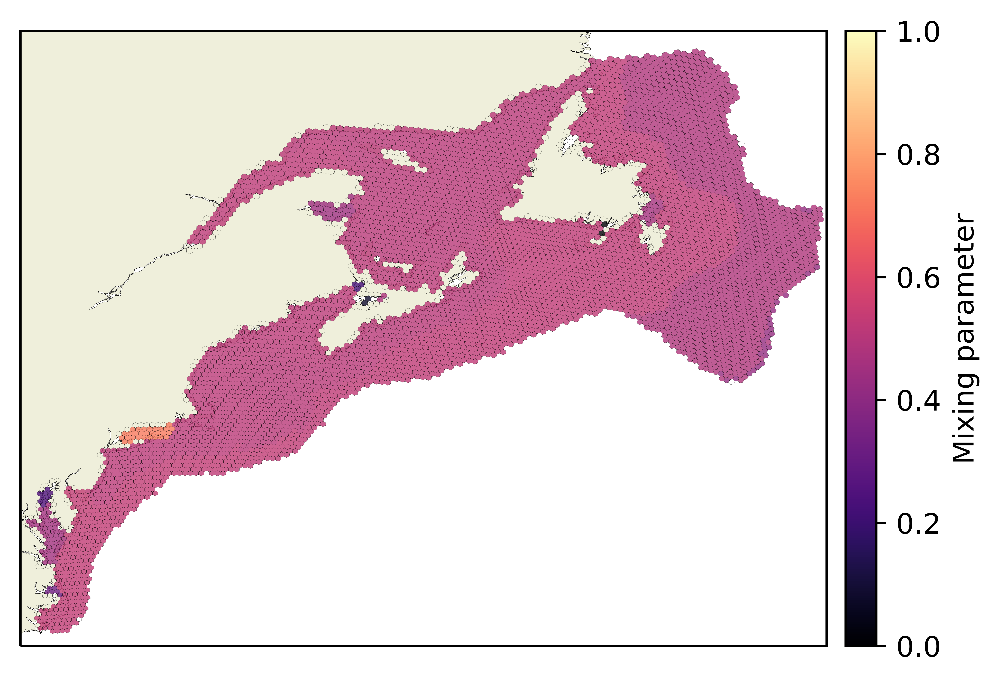

In [10]:
for module in modules:
    module.calculate_mixing(transition_matrix, hexbins)

plot_quality(
    hexbins,
    parameter='mixing',
    other_hexagons=domain_hexbins,
    colorbar_label='Mixing parameter',
    path=path / f'{seed}_mp',
)

## Boundary persistence

*Infomap* suffers from solution degeneracy (see Reijnders et al. 2021). Each hexbin can be classified as acting as a boundary to another module if it has a directly adjacent hexbin belonging to another module. The fraction of seeds in which a hexbin acts as a boundary is the boundary persistence. Plotting boundary persistence gives a high-level understanding of how solutions differ from the best seed.


In [11]:
seed_modules, seed_hexbins = zip(*[Module.read_clu(seed, label_map) for seed in seeds])

In [12]:
boundary_hexbins = tuple(hexbin for hexbins in seed_hexbins for hexbin in hexbins if hexbin.is_boundary(hexbins, hexbin_dict))

for hexbin in hexbins:
    hexbin.set_boundary_persistence(boundary_hexbins)

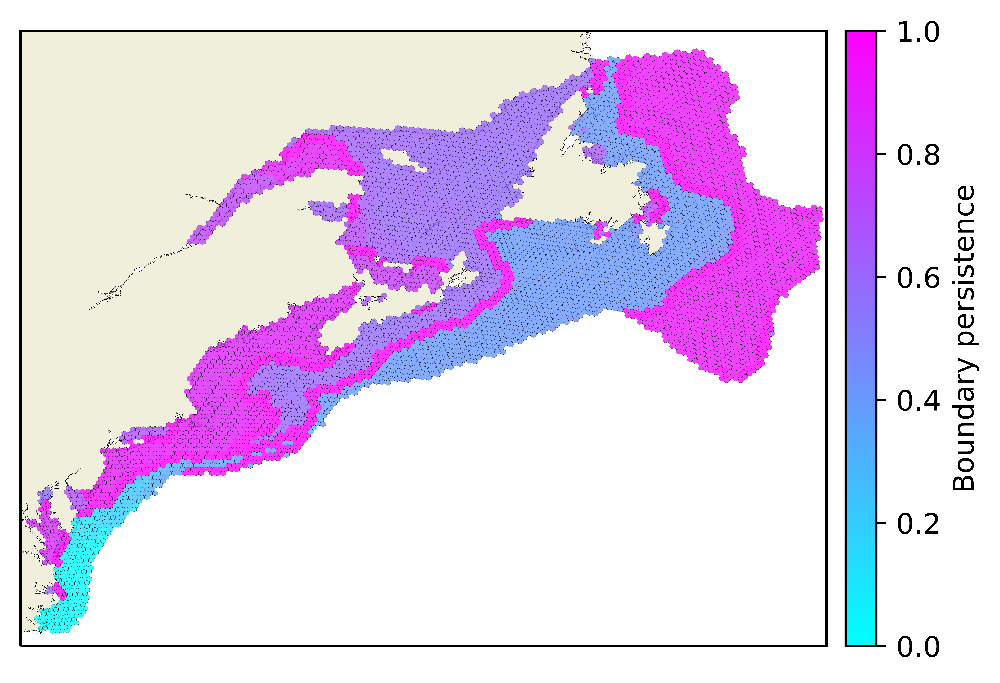

In [13]:
plot_boundary_persistence(hexbins)